<a href="https://colab.research.google.com/github/KimSeonHo-719/DRL/blob/main/MountainCarContinuous.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
# 1) gymnasium 설치
!pip install gymnasium[classic_control] pyglet       # 렌더링을 위해 pyglet 추가
!pip install torch  # PyTorch 설치

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 984.0/984.0 kB 18.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 5.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 127.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 93.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 53.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 2.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 5.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 20.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 7.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 6.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 108.4 MB/s eta 0:00:00
  Attempting uninstall: nvidia-nvjitlink-cu12
    Found existing installation: nvidia-nvjitlink-cu12 12.5.82
    Uninsta

In [2]:
!pip install torch  # PyTorch 설치# 2) 라이브러리 임포트
import gymnasium as gym
import numpy as np
from IPython import display
import matplotlib.pyplot as plt

In [3]:
# 3) 환경 생성
env = gym.make('MountainCarContinuous-v0', render_mode='rgb_array')
obs, info = env.reset(seed=42)

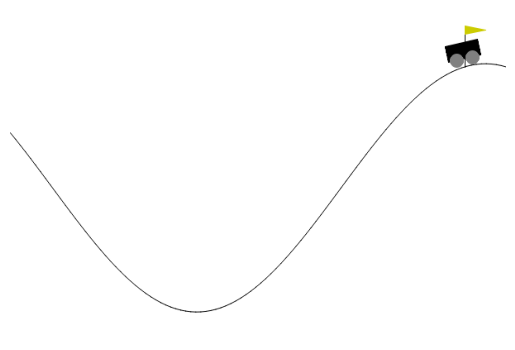

In [4]:
# 4) 랜덤 정책으로 1 에피소드 실행하며 애니메이션 만들기
frames = []
done = False

while not done:
    # action_space.sample()으로 랜덤 액션
    action = env.action_space.sample()
    obs, reward, done, truncated, info = env.step(action)
    frames.append(env.render())  # 매 단계마다 프레임 저장

# Colab에서 애니메이션으로 표시
plt.axis('off')
im = plt.imshow(frames[0])
def update(i):
    im.set_data(frames[i])
    return [im]

from matplotlib import animation
anim = animation.FuncAnimation(plt.gcf(), update, frames=len(frames), interval=30)
display.HTML(anim.to_jshtml())